In [16]:
import warnings
warnings.filterwarnings('ignore')

In [17]:
!pip -q install numpy pandas matplotlib seaborn geopy folium datetime scipy sklearn tensorflow


[notice] A new release of pip available: 22.3.1 -> 23.1.2
[notice] To update, run: python.exe -m pip install --upgrade pip


In [18]:
# installing libraries installer

%matplotlib inline

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import geopy.distance

from math import radians,cos,sin,asin,sqrt

import folium 
from folium.plugins import HeatMap

import datetime
from scipy.stats import ttest_ind

import matplotlib
matplotlib.rcParams.update({'font.size': 12})



# Loading the Data

In [19]:
uber_data =pd.read_csv('C:/Users/91706/OneDrive/Desktop/Data Science/Uber Trips Analysis/data/uber-raw-data-apr14.csv')

In [20]:
# Print the first 10 elements
display(uber_data.head(10))

,Date/Time,Lat,Lon,Base
0,4/1/2014 0:11:00,40.7690,-73.9549,B02512
1,4/1/2014 0:17:00,40.7267,-74.0345,B02512
2,4/1/2014 0:21:00,40.7316,-73.9873,B02512
3,4/1/2014 0:28:00,40.7588,-73.9776,B02512
4,4/1/2014 0:33:00,40.7594,-73.9722,B02512
5,4/1/2014 0:33:00,40.7383,-74.0403,B02512
6,4/1/2014 0:39:00,40.7223,-73.9887,B02512
7,4/1/2014 0:45:00,40.7620,-73.9790,B02512
8,4/1/2014 0:55:00,40.7524,-73.9960,B02512
9,4/1/2014 1:01:00,40.7575,-73.9846,B02512


# 2.Preprocessing the Data

In [21]:
print(uber_data.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 564516 entries, 0 to 564515
Data columns (total 4 columns):
 #   Column     Non-Null Count   Dtype  
---  ------     --------------   -----  
 0   Date/Time  564516 non-null  object 
 1   Lat        564516 non-null  float64
 2   Lon        564516 non-null  float64
 3   Base       564516 non-null  object 
dtypes: float64(2), object(2)
memory usage: 17.2+ MB
None


### 1.Change the type of Data in column

In [22]:
# Print the type of data in date/time
print(type(uber_data.loc[0,'Date/Time']))

<class 'str'>


In [23]:
uber_data['Date/Time'] = pd.to_datetime(uber_data['Date/Time'])

### 2.Dividing the Data 

In [24]:
# Create a new column to store this new binned column
uber_data['BinnedHour'] = uber_data['Date/Time'].dt.floor('15min')

In [25]:
# Printing the new column binnedHour
display(uber_data['BinnedHour'])

0        2014-04-01 00:00:00
1        2014-04-01 00:15:00
2        2014-04-01 00:15:00
3        2014-04-01 00:15:00
4        2014-04-01 00:30:00
                 ...        
564511   2014-04-30 23:15:00
564512   2014-04-30 23:15:00
564513   2014-04-30 23:30:00
564514   2014-04-30 23:30:00
564515   2014-04-30 23:45:00
Name: BinnedHour, Length: 564516, dtype: datetime64[ns]

### 3.Visualising the Data

#### 1. Let us visualize the total uber rides per day in the month of April 2014

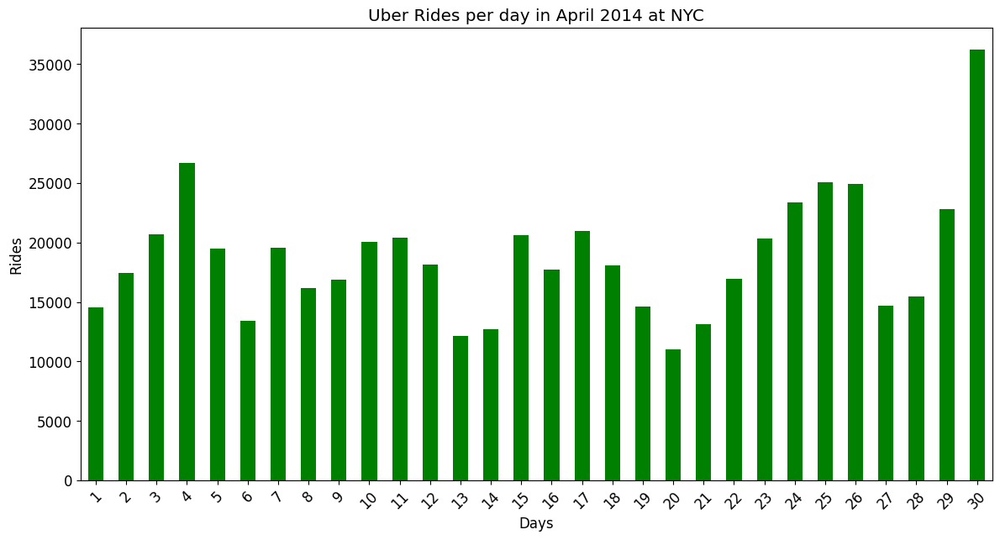

In [26]:
plt.figure(figsize=(14,7))
uber_data['BinnedHour'].dt.day.value_counts().sort_index().plot(kind='bar',color='green')
for item in plt.gca().get_xticklabels():
    item.set_rotation(45)
plt.title('Uber Rides per day in April 2014 at NYC')
plt.xlabel('Days')
plt.ylabel('Rides')
plt.show()

#### Observation 1: There is a recurring pattern in the data! The frequency of trips increases and then decreases in a repeating pattern.

#### 2. Let us have a more closer look at it, say every 15 minutes from April 1 to April 31

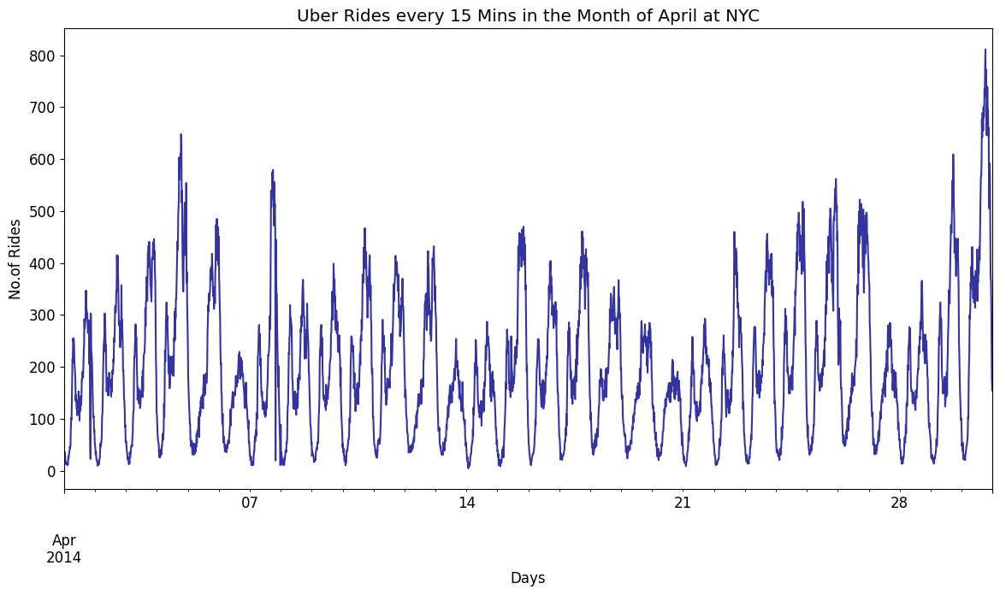

In [27]:
plt.figure(figsize =(14,7))
uber_data['BinnedHour'].value_counts().sort_index().plot(c='darkblue',alpha =0.8)
plt.title('Uber Rides every 15 Mins in the Month of April at NYC')
plt.xlabel('Days')
plt.ylabel('No.of Rides')
plt.show()


#### Observation 2: The underlying trend is clearly visible now. It conveys that in a day there are times when the pickups are very low and very high, and they seem to follow a pattern.

#### Q. Which times correspond to the highest and lowest peaks in the plot above?

In [28]:
display(uber_data['BinnedHour'].value_counts())

BinnedHour
2014-04-30 18:30:00    811
2014-04-30 18:15:00    780
2014-04-30 19:00:00    772
2014-04-30 20:00:00    739
2014-04-30 17:45:00    735
                      ... 
2014-04-14 02:30:00     10
2014-04-21 02:15:00      9
2014-04-14 01:15:00      9
2014-04-15 02:15:00      9
2014-04-14 01:30:00      5
Name: count, Length: 2880, dtype: int64

#### Ans.
The highest peak corresponds to the time 18.30 (6:30 PM), 30th April 2014 and has a ride count of 811 and the lowest peak corresponds to the time 01:30, 14th April 2014 and has a ride count of 5.

#### 3. Lets visualize the week wise trends in the data.
For this, we will have to map each date into its day name using a dictionary.

In [29]:
# Defining a dictionary to map the weekday to day name
DayMap = {0:'Monday', 1:'Tuesday', 2:'Wednesday', 3:'Thursday', 4:'Friday', 5:'Saturday', 6:'Sunday'}
uber_data['Day']= uber_data['BinnedHour'].dt.weekday.map(DayMap)
display(uber_data['Day'])

0           Tuesday
1           Tuesday
2           Tuesday
3           Tuesday
4           Tuesday
            ...    
564511    Wednesday
564512    Wednesday
564513    Wednesday
564514    Wednesday
564515    Wednesday
Name: Day, Length: 564516, dtype: object

In [30]:
# Separating the date and time to other columns
uber_data['Date'] =uber_data['BinnedHour'].dt.date
uber_data['Time'] =uber_data['BinnedHour'].dt.date
display(uber_data[['Date','Time']])

,Date,Time
0,2014-04-01,2014-04-01
1,2014-04-01,2014-04-01
2,2014-04-01,2014-04-01
3,2014-04-01,2014-04-01
4,2014-04-01,2014-04-01
...,...,...
564511,2014-04-30,2014-04-30
564512,2014-04-30,2014-04-30
564513,2014-04-30,2014-04-30
564514,2014-04-30,2014-04-30


In [31]:
# Defining ordered category of week days for easy sorting and visualization
uber_data['Day'] = pd.Categorical(uber_data['Day'],
                                 categories=['Monday','Tuesday','Wednesday','Thursday','Friday','Saturday','Sunday'],
                                  ordered = True)

In [32]:
weekly_data = uber_data.groupby(['Date','Day','Time']).count().dropna()\
                   .rename(columns={'BinnedHour':'Rides'})['Rides'].reset_index()
weekly_data.head(10)


,Date,Day,Time,Rides
0,2014-04-01,Monday,2014-04-01,0
1,2014-04-01,Monday,2014-04-02,0
2,2014-04-01,Monday,2014-04-03,0
3,2014-04-01,Monday,2014-04-04,0
4,2014-04-01,Monday,2014-04-05,0
5,2014-04-01,Monday,2014-04-06,0
6,2014-04-01,Monday,2014-04-07,0
7,2014-04-01,Monday,2014-04-08,0
8,2014-04-01,Monday,2014-04-09,0
9,2014-04-01,Monday,2014-04-10,0


In [33]:
weekly_data = uber_data.groupby(['Date','Day','Time']).count().dropna()\
                .rename(columns={'BinnedHour':'Rides'})['Rides'].reset_index()
weekly_data.head(10)

,Date,Day,Time,Rides
0,2014-04-01,Monday,2014-04-01,0
1,2014-04-01,Monday,2014-04-02,0
2,2014-04-01,Monday,2014-04-03,0
3,2014-04-01,Monday,2014-04-04,0
4,2014-04-01,Monday,2014-04-05,0
5,2014-04-01,Monday,2014-04-06,0
6,2014-04-01,Monday,2014-04-07,0
7,2014-04-01,Monday,2014-04-08,0
8,2014-04-01,Monday,2014-04-09,0
9,2014-04-01,Monday,2014-04-10,0


In [34]:
import pandas as pd

weekly_data['Date'] = pd.to_datetime(weekly_data['Date'])
weekly_data['Day'] = weekly_data['Date'].dt.day_name()

daywise = weekly_data.groupby('Day')['Rides'].sum()
print(daywise)

Day
Friday        90303
Monday        60861
Saturday      77218
Sunday        51251
Thursday      85067
Tuesday       91185
Wednesday    108631
Name: Rides, dtype: int64


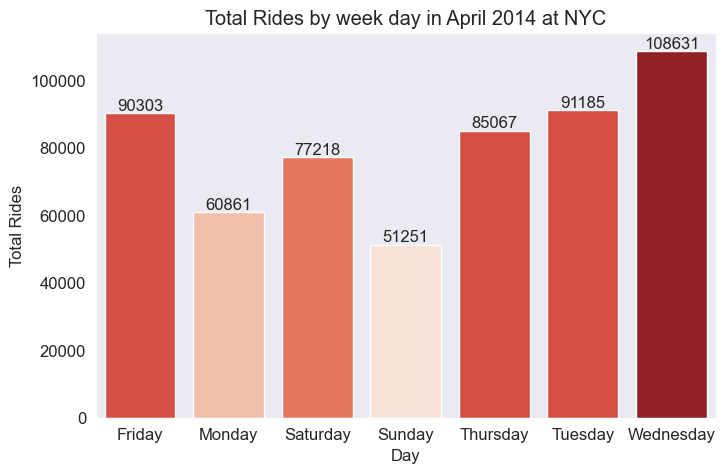

In [35]:
# Plotting the Graphs for a better visualization
sns.set_style("dark")
plt.figure(figsize=(8,5))

# Creating a customized color palette for cusom hue according to height of bars
vals = daywise.to_numpy().ravel()
normalized = (vals - np.min(vals)) / (np.max(vals) - np.min(vals))
indices = np.round(normalized*(len(vals) - 1)).astype(np.int32)
palette = sns.color_palette('Reds', len(vals))
colorPal = np.array(palette).take(indices, axis=0)

# Creating a bar plot
ax = sns.barplot(x = daywise.index,y= vals, palette=colorPal)
plt.ylabel('Total Rides')
plt.title('Total Rides by week day in April 2014 at NYC')
for rect in ax.patches:
    ax.text(rect.get_x() + rect.get_width()/2.0,rect.get_height(), int(rect.get_height()), ha='center', va='bottom')

#### Observation 3: According to the bar plot above, rides are maximum on Thursdays and minimum on Sundays. Sundays having the lowest number of rides makes sense logically, as it's a holiday and people often take rest on that day.

In [36]:
# Convert 'Rides' column to numeric type
weekly_data['Rides'] = pd.to_numeric(weekly_data['Rides'], errors='coerce')

# Group by 'Day' and 'Time', and calculate the mean of 'Rides'
weekly_mean = weekly_data.groupby(['Day', 'Time'])['Rides'].mean()

# Display the result
display(weekly_mean.head(10))

Day     Time      
Friday  2014-04-01      0.000000
        2014-04-02      0.000000
        2014-04-03      0.000000
        2014-04-04    954.071429
        2014-04-05      0.000000
        2014-04-06      0.000000
        2014-04-07      0.000000
        2014-04-08      0.000000
        2014-04-09      0.000000
        2014-04-10      0.000000
Name: Rides, dtype: float64

In [37]:
weekly_data = weekly_data.groupby(['Day','Time']).mean()['Rides']
display(weekly_data.head(10))

Day     Time      
Friday  2014-04-01      0.000000
        2014-04-02      0.000000
        2014-04-03      0.000000
        2014-04-04    954.071429
        2014-04-05      0.000000
        2014-04-06      0.000000
        2014-04-07      0.000000
        2014-04-08      0.000000
        2014-04-09      0.000000
        2014-04-10      0.000000
Name: Rides, dtype: float64

In [54]:
# Unstacking the data to create heatmap
weekly_data = weekly_data.unstack(level =0)
display(weekly_data)

Day,Friday,Monday,Saturday,Sunday,Thursday,Tuesday,Wednesday
Time,,,,,,,
2014-04-01,0.000000,0.000000,0.000000,0.000000,0.000000,415.600000,0.000000
2014-04-02,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,499.257143
2014-04-03,0.000000,0.000000,0.000000,0.000000,739.321429,0.000000,0.000000
2014-04-04,954.071429,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
2014-04-05,0.000000,0.000000,697.178571,0.000000,0.000000,0.000000,0.000000
2014-04-06,0.000000,0.000000,0.000000,480.178571,0.000000,0.000000,0.000000
2014-04-07,0.000000,698.214286,0.000000,0.000000,0.000000,0.000000,0.000000
2014-04-08,0.000000,0.000000,0.000000,0.000000,0.000000,462.514286,0.000000
2014-04-09,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,481.228571


In [39]:
plt.figure(figsize=(11,16))
sns.heatmap(weekly_data, cmap='Greens')
plt.title('Heatmap of average rides in time vs. day grid')

IndexError: Inconsistent shape between the condition and the input (got (210, 1) and (210,))

<Figure size 1100x1600 with 0 Axes>

Here's another way to look at it using line graphs

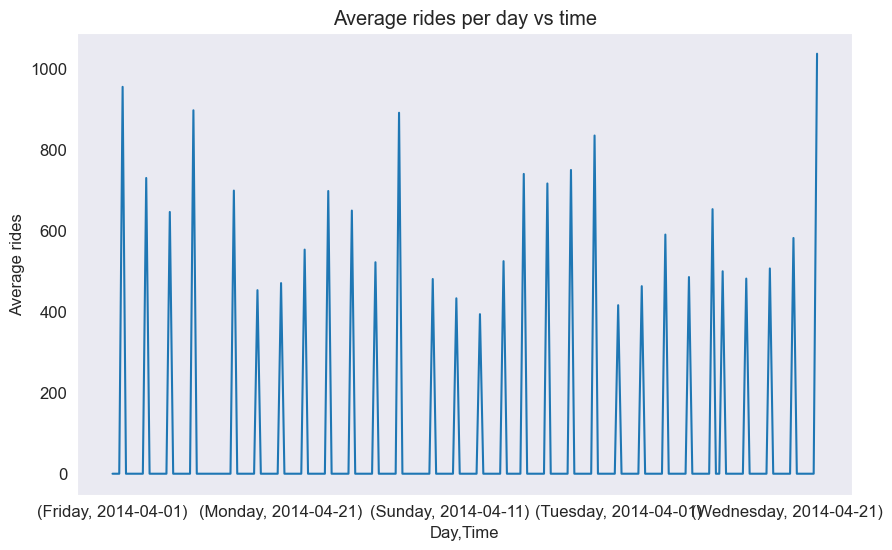

In [40]:
plt.figure(figsize=(10,6))
weekly_data.plot(ax=plt.gca())
plt.title('Average rides per day vs time')
plt.ylabel('Average rides')
plt.locator_params(axis='x', nbins=10)
plt.show()

We can also plot the average rides on any day as follows.

In [41]:
plt.figure(figsize=(10,6))
weekly_data.T.mean().plot(c ='black')
plt.title('Average uber rides on any day in April 2014 at NYC')
plt.locator_params(axis='x', nbins=10)
plt.show()

AttributeError: 'numpy.float64' object has no attribute 'plot'

<Figure size 1000x600 with 0 Axes>

In [42]:
plt.figure(figsize=(10,6))
weekly_data.T.mean().plot(c = 'black')
plt.title('Average uber rides on any day in July 2014 at NYC')
plt.locator_params(axis='x', nbins=10)
plt.show()

AttributeError: 'numpy.float64' object has no attribute 'plot'

<Figure size 1000x600 with 0 Axes>

Observation 4: This plot further confirms that the average rides on any given day is lowest around 2 AM and highest in the around 5:30 PM.

#### 4. Let's visualise the relationship between Base and total number of rides in July 2014.

In [43]:
# A mapper to map base number with its name
BaseMapper = {'B02512' : 'Unter', 'B02598' : 'Hinter', 'B02617' : 'Weiter', 'B02682' : 'Schmecken',
              'B02764' : 'Danach-NY'}


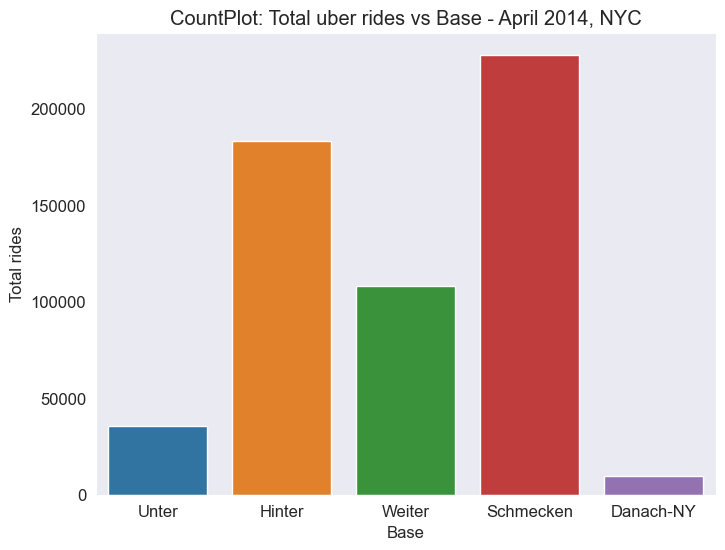

In [65]:
# Count plot of Base
plt.figure(figsize=(8,6))
sns.set_style("dark")
sns.countplot(x=uber_data['Base'].map(BaseMapper))
plt.ylabel('Total rides')
plt.title('CountPlot: Total uber rides vs Base - April 2014, NYC')
plt.show()

Observation 5: The above plot tells us that most uber rides originated from Weiter Base and least from Danach-NY.

#### 5. Now let's make use of latitude and longitude data to see how the uber trips' frequency is distributed across NYC.

We will need some center of city to act as origin and we will plot the rest of the coordinates around it.

For the example given below, we consider the center as Metropolitan Museum in NYC, whose coordinates are metro_art_coordinates = (40.7794,-73.9632).

In [45]:
metro_art_coordinates = (40.7794,-73.9632)


In [46]:
# Initiate the map around NYC and set the zoom level at 10
uber_map = folium.Map(location = metro_art_coordinates, zoom_start =10)

# Let's mark MM on the map
folium.Marker(metro_art_coordinates, popup = "Metropolitan Museum").add_to(uber_map)

# Covert to numpy array and plot it
Lat_Lon = uber_data[['Lat', 'Lon']].to_numpy()
folium.plugins.HeatMap(Lat_Lon,radius =10).add_to(uber_map)

# Displaying the map
display(uber_map)


In [47]:
uber_data['Weight'] = 0.5

Lat_Lon = uber_data[['Lat', 'Lon', 'Weight']].to_numpy()

# Plotting
uber_map = folium.Map(metro_art_coordinates, zoom_start=10)
folium.Marker(metro_art_coordinates, popup = "Metropolitan Museum").add_to(uber_map)
folium.plugins.HeatMap(Lat_Lon, radius = 15).add_to(uber_map)

display(uber_map)

#### 6. Let's visualize the timed data of trips, as a time lapse on a map!

In [48]:
# Create a copy of data
map_data = uber_data.copy()

# Use a smaller weight
map_data['Weight'] = 0.4

# Generate samples for each timestamp in "BinnedHour" (these are the points that are plotted for each timestamp )
map_data = map_data.groupby("BinnedHour").apply(lambda x:x[['Lat', 'Lon', 'Weight']]
                                               .sample(int(len(x)/3)).to_numpy().tolist())

In [49]:
# Create a copy of data
map_data = uber_data.copy()

# Use a smaller weight
map_data['Weight'] = 0.4

# Generate samples for each timestamp in "BinnedHour"
map_data = map_data.groupby("BinnedHour").apply(lambda x: x[['Lat', 'Lon', 'Weight']]
                                                .sample(int(len(x) / 3)).to_numpy().tolist())

In [10]:
print(uber_data.columns)

Index(['Date/Time', 'Lat', 'Lon', 'Base'], dtype='object')


In [50]:
display(map_data)

BinnedHour
2014-04-01 00:00:00    [[40.7613, -73.9857, 0.4], [40.7145, -73.9922,...
2014-04-01 00:15:00    [[40.7217, -73.989, 0.4], [40.7636, -73.9756, ...
2014-04-01 00:30:00    [[40.7078, -74.012, 0.4], [40.7481, -73.9569, ...
2014-04-01 00:45:00    [[40.753, -73.9929, 0.4], [40.7036, -73.8955, ...
2014-04-01 01:00:00    [[40.728, -73.9992, 0.4], [40.7245, -73.9914, ...
                                             ...                        
2014-04-30 22:45:00    [[40.6635, -73.9895, 0.4], [40.7358, -73.9883,...
2014-04-30 23:00:00    [[40.7139, -73.9637, 0.4], [40.7277, -73.9911,...
2014-04-30 23:15:00    [[40.76, -73.9761, 0.4], [40.7741, -73.8729, 0...
2014-04-30 23:30:00    [[40.7308, -74.0008, 0.4], [40.7202, -73.9982,...
2014-04-30 23:45:00    [[40.6596, -73.9626, 0.4], [40.742, -74.0037, ...
Length: 2880, dtype: object

In [51]:
# The index to be passed on to heatmapwithtime needs to be a time series of the following format
data_hour_index = [x.strftime("%m%d%Y , %H:%M:%S") for x in map_data.index]

# Covert to list to feed it to heatmapwithtime
date_hour_data = map_data.tolist()

# Initialize Map
uber_map = folium.Map(location=metro_art_coordinates, zoom_start =10)


In [52]:
# Plotting
hm = folium.plugins.HeatMapWithTime(date_hour_data, index=date_hour_data)

# Add heatmap to folium map (uber_map)
hm.add_to(uber_map)
display(uber_map)

#### 7. Finally, let's make one hypothesis and test if it is true by visualizing the data for that case.

Hypothesis: In early morning, weekends have more rides. The reasoning is - People often go out at night during the weekends.

In [62]:
weekends = weekly_data[['Saturday', 'Sunday']]
weekdays = weekly_data.drop(['Saturday', 'Sunday'], axis=1)

KeyError: "None of [Index(['Saturday', 'Sunday'], dtype='object')] are in the [columns]"

In [63]:
weekly_data = weekly_data.to_frame()

AttributeError: 'DataFrame' object has no attribute 'to_frame'

In [64]:
weekends = weekly_data[['Saturday', 'Sunday']]
weekdays = weekly_data.drop(['Saturday', 'Sunday'], axis=1)

KeyError: "None of [Index(['Saturday', 'Sunday'], dtype='object')] are in the [columns]"

In [59]:
print(weekly_data.columns)

Index(['Rides'], dtype='object')


In [60]:
print(type(weekly_data))

<class 'pandas.core.frame.DataFrame'>


In [65]:
print(weekly_data.head())

                        Rides
Day    Time                  
Friday 2014-04-01    0.000000
       2014-04-02    0.000000
       2014-04-03    0.000000
       2014-04-04  954.071429
       2014-04-05    0.000000


In [66]:
weekends = weekly_data[['Saturday', 'Sunday']]
weekdays = weekly_data.drop(['Saturday', 'Sunday'], axis=1)

KeyError: "None of [Index(['Saturday', 'Sunday'], dtype='object')] are in the [columns]"

In [56]:
weekends = weekends.mean(axis=1)
weekdays = weekdays.mean(axis=1)

display(weekends)
display(weekdays)


ValueError: No axis named 1 for object type Series

In [61]:
weekdays_weekends = pd.concat([weekdays,weekends], axis=1)
weekdays_weekends.columns = ['Weekdays', 'Weekends']
display(weekdays_weekends)

Weekdays    Weekends
Day    Time                              
Friday 2014-04-01    0.000000         NaN
       2014-04-02    0.000000         NaN
       2014-04-03    0.000000         NaN
       2014-04-04  954.071429         NaN
       2014-04-05    0.000000         NaN
...                       ...         ...
Sunday 2014-04-26         NaN    0.000000
       2014-04-27         NaN  524.178571
       2014-04-28         NaN    0.000000
       2014-04-29         NaN    0.000000
       2014-04-30         NaN    0.000000

[210 rows x 2 columns]

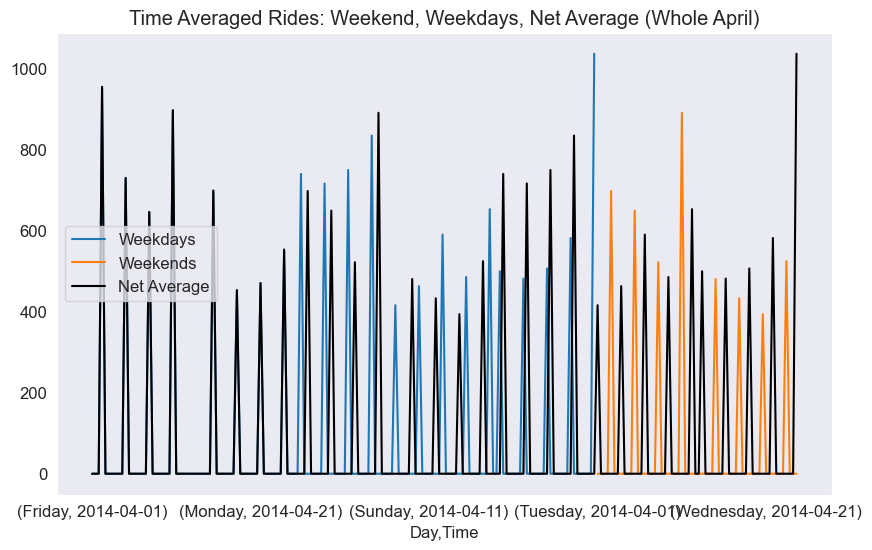

In [67]:
plt.figure(figsize=(10,6))
weekdays_weekends.plot(ax=plt.gca())
weekly_data.T.mean().plot(ax=plt.gca(),c = 'black',label='Net Average')
plt.title('Time Averaged Rides: Weekend, Weekdays, Net Average (Whole April)')
plt.legend()
plt.show()

#### Observation 6: The plot clearly shows - In early morning, weekends have more rides. This makes sense as people often go out at night during the weekends.
The number of rides around 8 AM is less on weekends, but more on weekdays as it is usually the time when people goto work. Also, in the weekends, there is a surge in the number of evening rides as people return from work.

With this, we finish our analysis of our Uber Pickups NYC Data.